In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import matplotlib.pyplot as plt
import os
import cv2
from skimage.io import imread

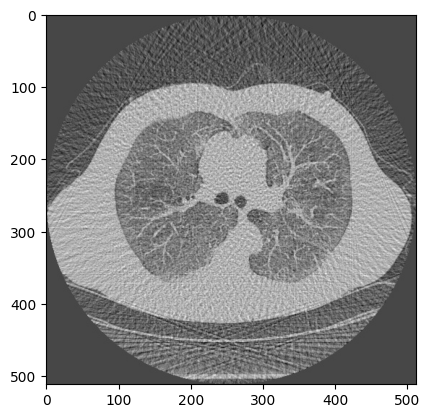

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/data/pro/64.png'))

['64.png', '48.png', '192.png', '96.png']


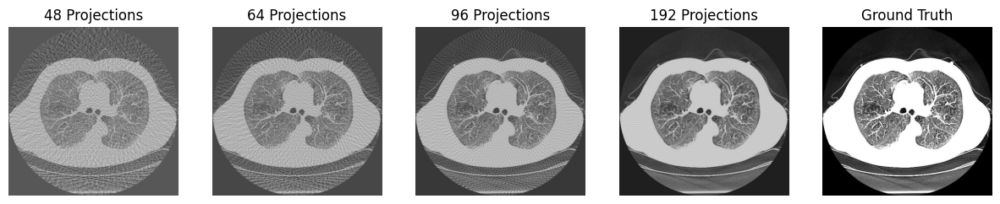

In [ ]:
og = f''
pro = f'/content/drive/MyDrive/data/pro'

pro_img = os.listdir(pro)
print(pro_img)
plt.figure(figsize=(15, 7))

display_list = ['/content/drive/MyDrive/data/pro/48.png', '/content/drive/MyDrive/data/pro/64.png', '/content/drive/MyDrive/data/pro/96.png', '/content/drive/MyDrive/data/pro/192.png', '/content/drive/MyDrive/data/og/og.jpeg']
# display_list.extend(pro_img)

title = ['48 Projections', '64 Projections','96 Projections', '192 Projections', 'Ground Truth']
# title.extend(pro_img)

for i in range(len(display_list)):
  plt.subplot(1, 5, i+1)
  plt.title(title[i])
  img = imread( display_list[i] )
  plt.imshow(img )
  plt.axis('off')
plt.savefig(f"temp.png")
plt.show()


In [ ]:
!unzip '/content/drive/MyDrive/GAN/logs.zip'

Archive:  /content/drive/MyDrive/GAN/logs.zip
   creating: logs/
   creating: logs/fit/
   creating: logs/fit/100epochs/
   creating: logs/fit/100epochs/20230804-045513/
  inflating: logs/fit/100epochs/20230804-045513/events.out.tfevents.1691124913.sg02064-125756.0-aisurrey11.surrey.ac.uk.1.0.v2  
   creating: logs/fit/100epochs/20230804-080032/
  inflating: logs/fit/100epochs/20230804-080032/events.out.tfevents.1691136032.sg02064-125765.0-aisurrey26.surrey.ac.uk.1.0.v2  
   creating: logs/fit/expwlr/
   creating: logs/fit/expwlr/20230802-080809/
  inflating: logs/fit/expwlr/20230802-080809/events.out.tfevents.1690963689.sg02064-125523.0-aisurrey26.surrey.ac.uk.1.0.v2  
   creating: logs/fit/expwlr/20230802-175402/
  inflating: logs/fit/expwlr/20230802-175402/events.out.tfevents.1690998842.sg02064-125564.0-aisurrey21.surrey.ac.uk.1.0.v2  
   creating: logs/fit/expwlr/20230803-010634/
  inflating: logs/fit/expwlr/20230803-010634/events.out.tfevents.1691024794.sg02064-125600.0-aisurrey21

In [ ]:
from glob import glob
import tensorflow as tf

import os
import time
import datetime

from matplotlib import pyplot as plt
# from IPython import display

BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256


def read_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image.set_shape([None, None, 3])
    image = tf.cast(image, dtype=tf.float32) / 255.0
    return image


def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image


# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

def load_data(low_light_image_path, enhanced_image_path):
    low_light_image = read_image(low_light_image_path)
    enhanced_image = read_image(enhanced_image_path)
    res_low, res_enhanced = resize(low_light_image, enhanced_image, 256,256)
    # low_light_image, enhanced_image = normalize(res_low, res_enhanced)
    return res_low, res_enhanced


def get_dataset(low_light_images, enhanced_images):
    dataset = tf.data.Dataset.from_tensor_slices((low_light_images, enhanced_images))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset


"""## Build the generator

The generator of your pix2pix cGAN is a _modified_ [U-Net](https://arxiv.org/abs/1505.04597){:.external}. A U-Net consists of an encoder (downsampler) and decoder (upsampler). (You can find out more about it in the [Image segmentation](../images/segmentation.ipynb) tutorial and on the [U-Net project website](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/){:.external}.)

- Each block in the encoder is: Convolution -> Batch normalization -> Leaky ReLU
- Each block in the decoder is: Transposed convolution -> Batch normalization -> Dropout (applied to the first 3 blocks) -> ReLU
- There are skip connections between the encoder and decoder (as in the U-Net).

Define the downsampler (encoder):
"""

OUTPUT_CHANNELS = 3

def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

# down_model = downsample(3, 4)
# down_result = down_model(tf.expand_dims(inp, 0))
# print (down_result.shape)

"""Define the upsampler (decoder):"""

def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

# up_model = upsample(3, 4)
# up_result = up_model(down_result)
# print (up_result.shape)

def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)


"""### Define the generator loss

GANs learn a loss that adapts to the data, while cGANs learn a structured loss that penalizes a possible structure that differs from the network output and the target image, as described in the [pix2pix paper](https://arxiv.org/abs/1611.07004){:.external}.

- The generator loss is a sigmoid cross-entropy loss of the generated images and an **array of ones**.
- The pix2pix paper also mentions the L1 loss, which is a MAE (mean absolute error) between the generated image and the target image.
- This allows the generated image to become structurally similar to the target image.
- The formula to calculate the total generator loss is `gan_loss + LAMBDA * l1_loss`, where `LAMBDA = 100`.
This value was decided by the authors of the paper.
"""
def peak_signal_noise_ratio(y_true, y_pred):
  return tf.image.psnr(y_true, y_pred, max_val = 255.0)

def structural_similarity(y_true, y_pred):
  return tf.image.ssim(y_true, y_pred, 225.0)

def generator_loss(disc_generated_output, gen_output, target):
    LAMBDA_PSNR = 0.8
    LAMBDA_SSIM = 1

    loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    psnr_loss = tf.reduce_mean(peak_signal_noise_ratio(target, gen_output))

    ssim_loss = tf.reduce_mean(structural_similarity(target, gen_output))
    # # Mean absolute error
    # l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA_PSNR * psnr_loss) + (LAMBDA_SSIM * ssim_loss)

    return total_gen_loss, gan_loss, ssim_loss, psnr_loss

"""The training procedure for the generator is as follows:

![Generator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gen.png?raw=1)

## Build the discriminator

The discriminator in the pix2pix cGAN is a convolutional PatchGAN classifier—it tries to classify if each image _patch_ is real or not real, as described in the [pix2pix paper](https://arxiv.org/abs/1611.07004){:.external}.

- Each block in the discriminator is: Convolution -> Batch normalization -> Leaky ReLU.
- The shape of the output after the last layer is `(batch_size, 30, 30, 1)`.
- Each `30 x 30` image patch of the output classifies a `70 x 70` portion of the input image.
- The discriminator receives 2 inputs:
    - The input image and the target image, which it should classify as real.
    - The input image and the generated image (the output of the generator), which it should classify as fake.
    - Use `tf.concat([inp, tar], axis=-1)` to concatenate these 2 inputs together.

Let's define the discriminator:
"""

def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

"""Visualize the discriminator model architecture:"""

# discriminator = Discriminator()
# tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

"""Test the discriminator:"""

# disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
# plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
# plt.colorbar()

"""### Define the discriminator loss

- The `discriminator_loss` function takes 2 inputs: **real images** and **generated images**.
- `real_loss` is a sigmoid cross-entropy loss of the **real images** and an **array of ones(since these are the real images)**.
- `generated_loss` is a sigmoid cross-entropy loss of the **generated images** and an **array of zeros (since these are the fake images)**.
- The `total_loss` is the sum of `real_loss` and `generated_loss`.
"""

def discriminator_loss(disc_real_output, disc_generated_output):
    loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss


    """## Training

- For each example input generates an output.
- The discriminator receives the `input_image` and the generated image as the first input. The second input is the `input_image` and the `target_image`.
- Next, calculate the generator and the discriminator loss.
- Then, calculate the gradients of loss with respect to both the generator and the discriminator variables(inputs) and apply those to the optimizer.
- Finally, log the losses to TensorBoard.
"""


@tf.function
def train_step(input_image, target, step, generator, discriminator, summary_writer):

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_total_loss, gen_gan_loss, gen_ssim_loss, gen_psnr_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    generator_gradients = gen_tape.gradient(gen_total_loss,
                                            generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                                discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(generator_gradients,
                                            generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                                discriminator.trainable_variables))

    with summary_writer.as_default():
        tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//3)
        tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//3)
        tf.summary.scalar('gen_psnr_loss', gen_psnr_loss, step=step//3)
        tf.summary.scalar('gen_ssim_loss', gen_ssim_loss, step=step//3)
        tf.summary.scalar('disc_loss', disc_loss, step=step//3)

    print('gen_total_loss', gen_total_loss, '\n',
        'gen_gan_loss', gen_gan_loss,  '\n',
        'gen_psnr_loss', gen_psnr_loss, '\n',
        'gen_ssim_loss', gen_ssim_loss, '\n',
        'disc_loss', disc_loss
    )

# @tf.function
# def val_step(val_dataset, generator, discriminator, summary_writer):

#     for step , (input_image , target) in val_dataset.enumerate():
#         gen_output = generator(input_image, training=True)

#         disc_real_output = discriminator([input_image, target], training=False)
#         disc_generated_output = discriminator([input_image, gen_output], training=False)

#         gen_total_loss, gen_gan_loss, gen_ssim_loss, gen_psnr_loss = generator_loss(disc_generated_output, gen_output, target)
#         disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

#         with summary_writer.as_default():
#             tf.summary.scalar('val_gen_total_loss', gen_total_loss, step=step)
#             tf.summary.scalar('val_gen_gan_loss', gen_gan_loss, step=step)
#             tf.summary.scalar('val_gen_psnr_loss', gen_psnr_loss, step=step)
#             tf.summary.scalar('val_gen_ssim_loss', gen_ssim_loss, step=step)
#             tf.summary.scalar('val_disc_loss', disc_loss, step=step)

#         print('gen_total_loss', gen_total_loss, '\n',
#             'gen_gan_loss', gen_gan_loss,  '\n',
#             'gen_psnr_loss', gen_psnr_loss, '\n',
#             'gen_ssim_loss', gen_ssim_loss, '\n',
#             'disc_loss', disc_loss
#         )

"""The actual training loop. Since this tutorial can run of more than one dataset, and the datasets vary greatly in size the training loop is setup to work in steps instead of epochs.

- Iterates over the number of steps.
- Every 10 steps print a dot (`.`).
- Every 1k steps: clear the display and run `generate_images` to show the progress.
- Every 5k steps: save a checkpoint.
"""

def fit(train_ds, test_ds, steps, generator, discriminator, val_writer, summary_writer):
    start = time.time()
    for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
        print("step", step,"*************************************************************************" )

        train_step(input_image, target, step, generator, discriminator, summary_writer )

        # Save (checkpoint) the model every 5 epochs i.e. steps / 18680
        num = (step +1) // 46690
        if (step + 1) % 46690 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)
            print(f"checkpoint {num} saved")
            path = f"/user/HS402/sg02064/dissertation/results/{num}"
            for example_input, example_target in val_ds.take(1):
                generate_images(generator, example_input, example_target, path, num, random.randint(0,1000) )

            # for input, target in val_ds.repeat().take(4).enumerate():
            #     generate_images(generator, input, target,path, random.randint(0,1000))
            print("Image generated")


def generate_images(model, test_input, tar, step, chk):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i])
    #  * 0.5 + 0.5
    plt.axis('off')
  # plt.savefig(f"model_{step}_{chk}.png")
  plt.show()

# """Test the function:"""

# for example_input, example_target in test_dataset.take(1):
#   generate_images(generator, example_input, example_target)





In [ ]:
generator = Generator()
discriminator = Discriminator()

generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 128)  131584      ['sequential[0][0]']             
                                                                                              

In [ ]:
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_image (InputLayer)       [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 target_image (InputLayer)      [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 concatenate_7 (Concatenate)    (None, 256, 256, 6)  0           ['input_image[0][0]',            
                                                                  'target_image[0][0]']     

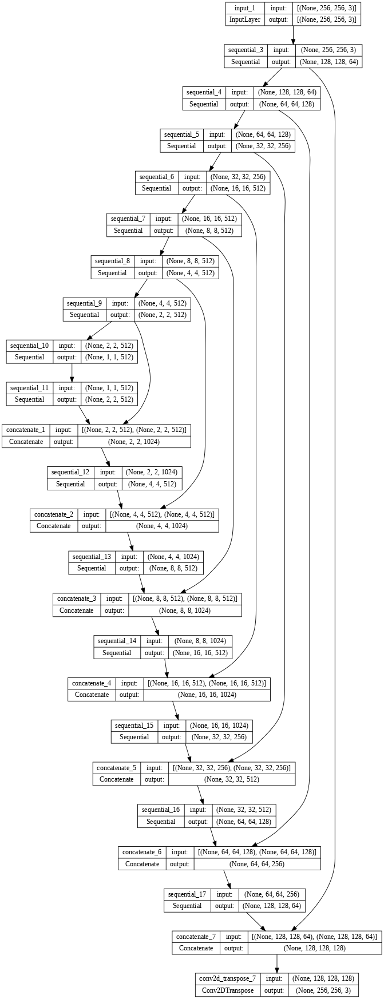

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

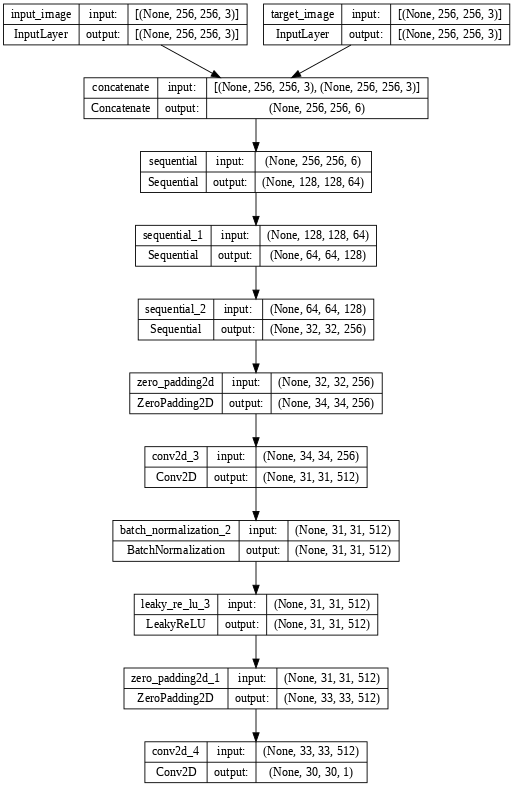

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

In [ ]:
generator = Generator()
discriminator = Discriminator()
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

checkpoint_dir = '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                              discriminator_optimizer=discriminator_optimizer,
                              generator=generator,
                              discriminator=discriminator)

val_low_light_images = sorted(glob( os.path.join(r"/content/drive/MyDrive/GAN/val/projections/*")))
val_enhanced_images = sorted(glob( os.path.join(r"/content/drive/MyDrive/GAN/val/original/*")))
val_dataset = get_dataset(val_low_light_images, val_enhanced_images)
print(len(val_dataset))

checkpoint.restore(tf.train.latest_checkpoint (checkpoint_dir))
# checkpoint.restore(tf.train.load (checkpoint_dir))
# generator.load_weights(checkpoint_prefix)

# for step, (input_image, target) in val_dataset.repeat().take(steps).enumerate():
#   generate_images(generator, input_image, target, step)

# for inp, tar in val_dataset.:


1


In [ ]:
generator = Generator()
discriminator = Discriminator()
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

checkpoint_dir = '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                              discriminator_optimizer=discriminator_optimizer,
                              generator=generator,
                              discriminator=discriminator)

val_low_light_images = sorted(glob( os.path.join(r"/content/drive/MyDrive/GAN/val/projections/*")))
val_enhanced_images = sorted(glob( os.path.join(r"/content/drive/MyDrive/GAN/val/original/*")))
val_dataset = get_dataset(val_low_light_images, val_enhanced_images)
print(len(val_dataset))

checkpoint.restore(tf.train.latest_checkpoint (checkpoint_dir))
# checkpoint.restore(tf.train.load (checkpoint_dir))
# generator.load_weights(checkpoint_prefix)

# for step, (input_image, target) in val_dataset.repeat().take(steps).enumerate():
#   generate_images(generator, input_image, target, step)

# for inp, tar in val_dataset.:


1


In [ ]:
import random

In [ ]:
generator = Generator()
discriminator = Discriminator()
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

checkpoint_dir = '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                              discriminator_optimizer=discriminator_optimizer,
                              generator=generator,
                              discriminator=discriminator)

val_low_light_images = sorted(glob( os.path.join(r"/content/drive/MyDrive/GAN/val/projections/*")))
val_enhanced_images = sorted(glob( os.path.join(r"/content/drive/MyDrive/GAN/val/original/*")))
val_dataset = get_dataset(val_low_light_images, val_enhanced_images)
print(len(val_dataset))

checkpoint.restore(tf.train.latest_checkpoint (checkpoint_dir))
# checkpoint.restore(tf.train.load (checkpoint_dir))
# generator.load_weights(checkpoint_prefix)

# for step, (input_image, target) in val_dataset.repeat().take(steps).enumerate():
#   generate_images(generator, input_image, target, step)

# for inp, tar in val_dataset.:


1


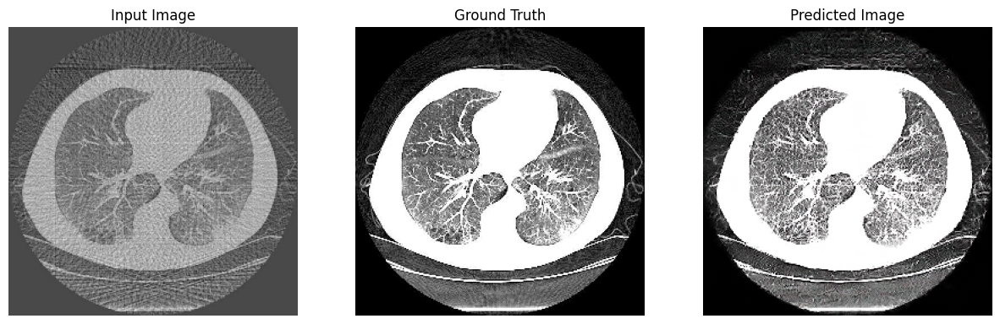

In [ ]:
for example_input, example_target in val_dataset.take(1):
  generate_images(generator, example_input, example_target, 366, 1)

<class 'tensorflow.python.framework.ops.EagerTensor'>


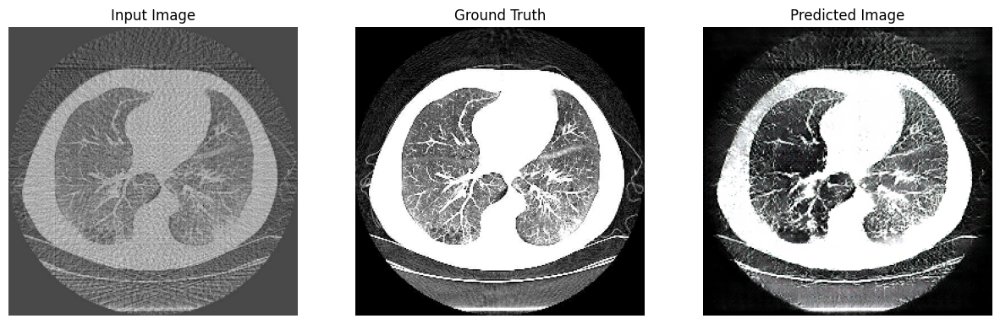

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-2
<class 'tensorflow.python.framework.ops.EagerTensor'>


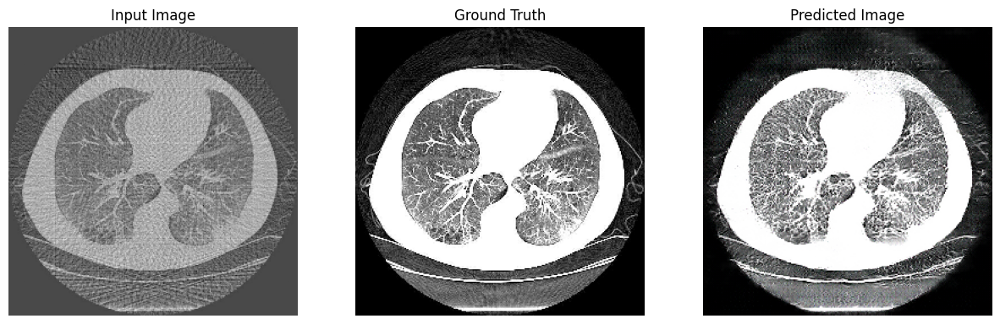

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-3
<class 'tensorflow.python.framework.ops.EagerTensor'>


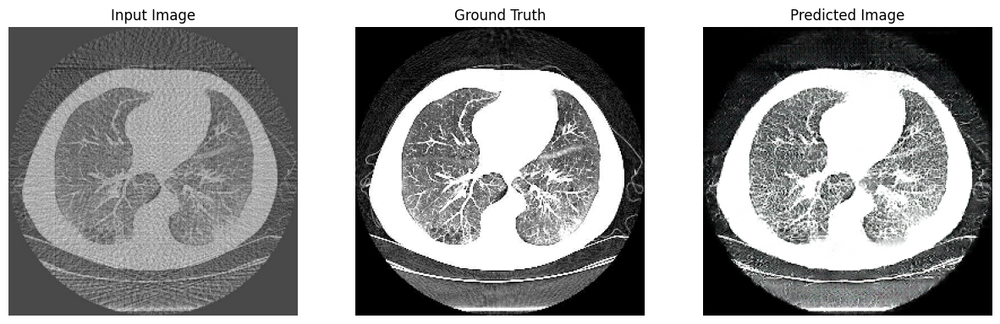

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-4
<class 'tensorflow.python.framework.ops.EagerTensor'>


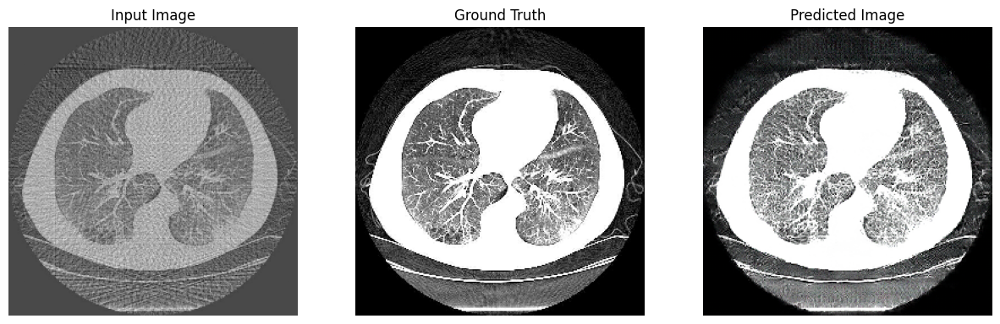

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-5
<class 'tensorflow.python.framework.ops.EagerTensor'>


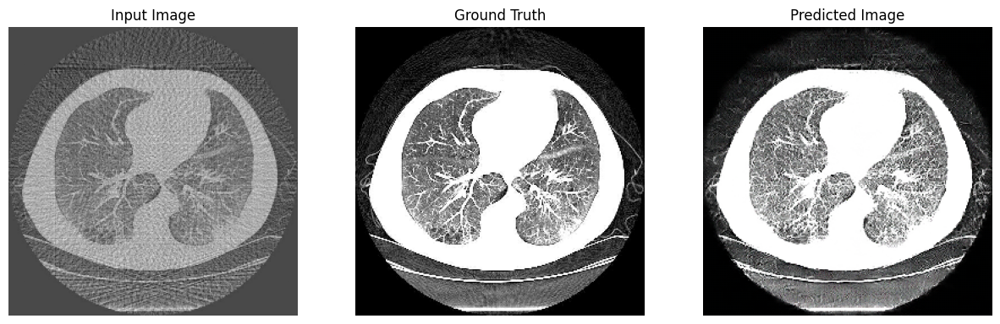

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-6
<class 'tensorflow.python.framework.ops.EagerTensor'>


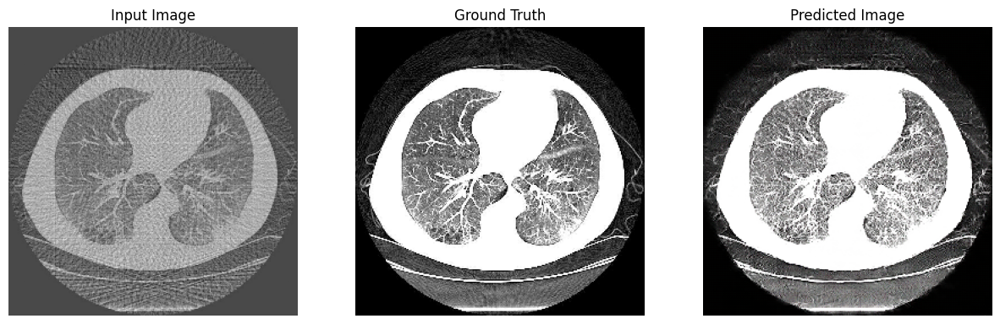

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-7
<class 'tensorflow.python.framework.ops.EagerTensor'>


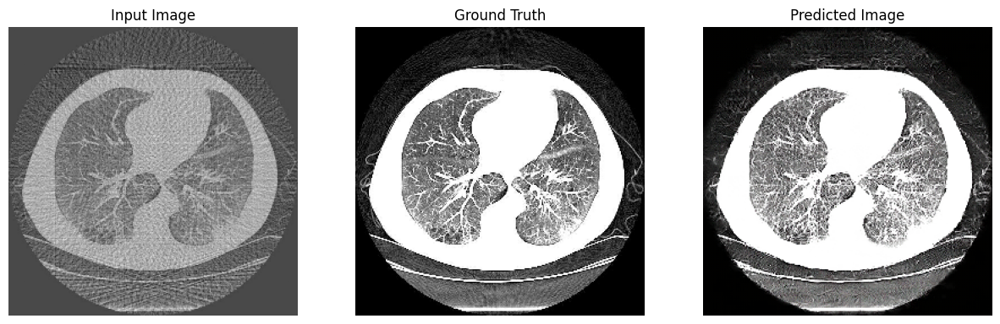

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-8
<class 'tensorflow.python.framework.ops.EagerTensor'>


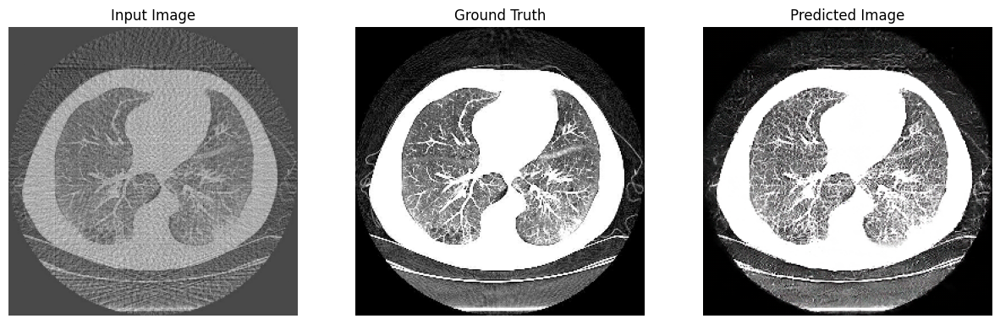

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-9


In [ ]:
import tensorflow as tf

# initial_learning_rate = 2e-4
# generator_lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
#     initial_learning_rate, decay_steps=46690, decay_rate=0.9
# )
# discriminator_lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
#     initial_learning_rate, decay_steps=46690, decay_rate=0.9
# )
# generator_optimizer = tf.keras.optimizers.Adam(generator_lr_schedule, beta_1=0.5)
# discriminator_optimizer = tf.keras.optimizers.Adam(discriminator_lr_schedule, beta_1=0.5)


# Directory containing checkpoint files
# checkpoint_dir = "path/to/checkpoints"
checkpoint_dir = '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints'
# checkpoint_dir = '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints'


check_list = []
checkpoint_prefix_list = []

# Iterate over checkpoint files
for checkpoint_file in sorted(tf.io.gfile.glob(checkpoint_dir + "/ckpt-*.index")):
    checkpoint_prefix = checkpoint_file[:-6]

    # Restore the model's weights
    checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                              discriminator_optimizer=discriminator_optimizer,
                              generator=generator,
                              discriminator=discriminator)
    check_list.append(checkpoint)
    checkpoint_prefix_list.append(checkpoint_prefix)
    checkpoint.restore(checkpoint_prefix)

    for example_input, example_target in val_dataset.take(1):
      print(type(example_input))
      generate_images(generator, example_input, example_target, 366, random.randint(1,11))
    print(checkpoint_prefix)

In [ ]:
checkpoint_prefix_list

['/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-1',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-2',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-3',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-4',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-5',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-6',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-7',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-8',
 '/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-9']

In [ ]:
# check_list.append(check_list.pop(check_list.index(1)))
# checkpoint_prefix_list.append(checkpoint_prefix_list.pop(checkpoint_prefix_list.index(1)))

for checkpoint, prefix in zip(check_list, checkpoint_prefix_list):
  print(prefix)
  print(checkpoint)

/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-1
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-2
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-3
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-4
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-5
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-6
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-7
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-8
/content/drive/MyDrive/GAN/exp2withlr/training_checkpoints/ckpt-9


In [ ]:
for i in range(0,4):
  input_image, target = next(iter(val_dataset.take(1)))
  generate_images(generator, input_image, target, i)

In [ ]:


generator = Generator()
discriminator = Discriminator()
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

checkpoint_dir = '/content/drive/MyDrive/GAN/100epochs/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                              discriminator_optimizer=discriminator_optimizer,
                              generator=generator,
                              discriminator=discriminator)

log_dir= r"logs/"

summary_writer = tf.summary.create_file_writer(
log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

root = r"dataset/"

train_low_light_images = sorted(glob( os.path.join(root,r"train/projections/*")))
train_enhanced_images = sorted(glob( os.path.join(root,r"train/originals/*")))

val_low_light_images = sorted(glob( os.path.join(root,r"val/projections/*")))
val_enhanced_images = sorted(glob( os.path.join(root,r"val/originals/*")))

# val_enhanced_images = sorted(glob(r"D:\F Drive\Shubham\surrey\data- ct\dataset\val\poriginals\*"))
print('train_low_light_images', len(train_low_light_images))
print('train_enhanced_images',len(train_enhanced_images))
print('val_low_light_images', len(val_low_light_images))
print('val_enhanced_images',len(val_enhanced_images))

print("____ Train Dataset")
train_dataset = get_dataset(train_low_light_images, train_enhanced_images)
print(len(train_dataset))


print("____ Val Dataset")
val_dataset = get_dataset(val_low_light_images, val_enhanced_images)
print(len(val_dataset))

print("Fit model")

# fit(train_dataset, val_dataset, 50, generator, discriminator, val_writer, summary_writer)
# example_input, example_target = next(iter(train_dataset.take(1)))
# generate_images(generator, example_input, example_target)



In [ ]:
import keras

In [ ]:
model  = keras.models.load_model("gen5.h5")

In [ ]:
!ls {checkpoint_dir}

checkpoint		     ckpt-5.data-00000-of-00001
ckpt-10.data-00000-of-00001  ckpt-5.index
ckpt-10.index		     ckpt-6.data-00000-of-00001
ckpt-1.data-00000-of-00001   ckpt-6.index
ckpt-1.index		     ckpt-7.data-00000-of-00001
ckpt-2.data-00000-of-00001   ckpt-7.index
ckpt-2.index		     ckpt-8.data-00000-of-00001
ckpt-3.data-00000-of-00001   ckpt-8.index
ckpt-3.index		     ckpt-9.data-00000-of-00001
ckpt-4.data-00000-of-00001   ckpt-9.index
ckpt-4.index


In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
!unzip /content/drive/MyDrive/GAN/ezyzip.zip

Archive:  /content/drive/MyDrive/GAN/ezyzip.zip
   creating: gan_20230816-041329/
  inflating: gan_20230816-041329/events.out.tfevents.1692159209.sg02064-127640.0-aisurrey19.surrey.ac.uk.1.0.v2  
   creating: gan_20230815-233132/
  inflating: gan_20230815-233132/events.out.tfevents.1692142292.sg02064-127640.0-aisurrey14.surrey.ac.uk.1.0.v2  
   creating: gan_20230815-223528/
  inflating: gan_20230815-223528/events.out.tfevents.1692138928.sg02064-127625.0-aisurrey14.surrey.ac.uk.1.0.v2  


In [ ]:
%load_ext tensorboard

In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir /content/logs/fit

<IPython.core.display.Javascript object>

In [ ]:
from packaging import version

import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
from scipy import stats
import tensorboard as tb

In [ ]:
major_ver, minor_ver, _ = version.parse(tb.__version__).release
assert major_ver >= 2 and minor_ver >= 3, \
    "This notebook requires TensorBoard 2.3 or later."
print("TensorBoard version: ", tb.__version__)

TensorBoard version:  2.12.3


In [ ]:
!tensorboard dev upload --logdir {/content/logs}

In [ ]:
experiment_id = "c1KCv3X3QvGwaXfgX1c4tg"
experiment = tb.data.experimental.ExperimentFromDev(experiment_id)
df = experiment.get_scalars()
df

,run,tag,step,value
0,"adam,run_1/train",epoch_accuracy,0,0.966867
1,"adam,run_1/train",epoch_accuracy,1,0.986283
2,"adam,run_1/train",epoch_accuracy,2,0.989333
3,"adam,run_1/train",epoch_accuracy,3,0.991933
4,"adam,run_1/train",epoch_accuracy,4,0.991733
...,...,...,...,...
1195,"sgd,run_5/validation",epoch_loss,15,0.020157
1196,"sgd,run_5/validation",epoch_loss,16,0.020212
1197,"sgd,run_5/validation",epoch_loss,17,0.020364
1198,"sgd,run_5/validation",epoch_loss,18,0.022192


# Line Spacing


In [ ]:
proj = '/content/drive/MyDrive/GAN/test/projections/img_235_48.jpeg'
og = '/content/drive/MyDrive/GAN/test/original/img_235_48.jpeg'

import numpy as np
from skimage.draw import line
from skimage.io import imread
import matplotlib.pyplot as plt

# Load your images (image1 and image2)
og_img = imread(og)
proj_img = imread(proj)

x1, x2, y1, y2 = 50, 250, 150, 100

# Define starting and ending points of the line
start_point = (y1, x1)  # Replace with your starting point coordinates
end_point = (y2, x2)    # Replace with your ending point coordinates

# Get coordinates of the line pixels
line_coords = line(*start_point, *end_point)

# Extract intensity values along the line from both images
intensity_profile_image1 = og_img[line_coords]
intensity_profile_image2 = proj_img[line_coords]


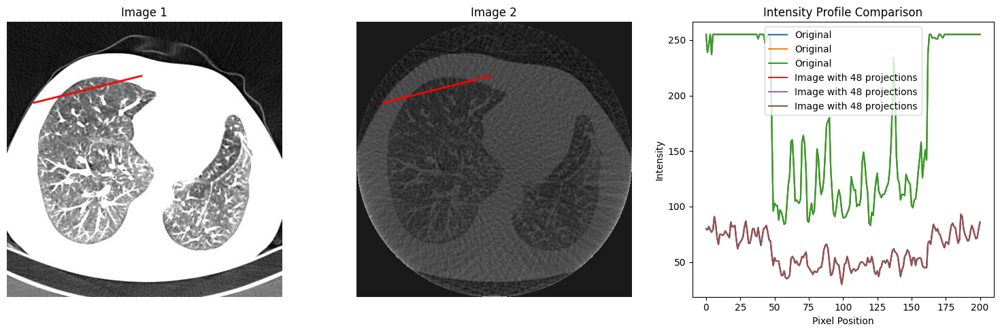

In [ ]:
# Create an array of pixel positions along the line
pixel_positions = np.arange(len(line_coords[0]))

# Plot the intensity profiles along with images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

# Plot Image 1
ax1.imshow(og_img, cmap='gray')
ax1.plot([x1, x2], [y1, y2], color='red', linewidth=2, label='Line')
ax1.set_title('Image 1')
ax1.axis('off')

# Plot Image 2
ax2.imshow(proj_img, cmap='gray')
ax2.plot([x1, x2], [y1, y2], color='red', linewidth=2, label='Line')
ax2.set_title('Image 2')
ax2.axis('off')

# Plot Intensity Profiles
ax3.plot(pixel_positions, intensity_profile_image1, label='Original')
ax3.plot(pixel_positions, intensity_profile_image2, label='Image with 48 projections')
ax3.set_xlabel('Pixel Position')
ax3.set_ylabel('Intensity')
ax3.set_title('Intensity Profile Comparison')
ax3.legend()

plt.tight_layout()
plt.show()

In [ ]:
pred = '/content/drive/MyDrive/mirnet/predictions/img_482.jpeg'
proj = '/content/test/projections/img_235_48.jpeg'
# og = '/content/drive/MyDrive/GAN/test/original/img_235_48.jpeg'
og = '/content/test/original/img_235_48.jpeg'

import numpy as np
from skimage.draw import line
from skimage.io import imread
import matplotlib.pyplot as plt

def get_diff_line(image1, image2):


  # Load your images (image1 and image2)
  image1 = imread(image1)
  image2 = imread(image2)

  x1, x2, y1, y2 = 50, 250, 300, 300

  # Define starting and ending points of the line
  start_point = (y1, x1)  # Replace with your starting point coordinates
  end_point = (y2, x2)    # Replace with your ending point coordinates

  # Get coordinates of the line pixels
  line_coords = line(*start_point, *end_point)

  # Extract intensity values along the line from both images
  intensity_profile_image1 = image1[line_coords]
  intensity_profile_image2 = image2[line_coords]
  return line_coords, intensity_profile_image1, intensity_profile_image2, x1,x2,y1,y2

In [ ]:
from matplotlib import colors
# prediction and gt
pred_line_coords,groundTruth_intensity, intensity_pred, x1,x2,y1,y2 = get_diff_line(og,pred)
# proj and Gt
proj_line_coords,groundTruth_intensity, intensity_proj, x1,x2,y1,y2 = get_diff_line(og,proj)


# Create an array of pixel positions along the line
pred_pixel_positions = np.arange(len(pred_line_coords[0]))
print(len(pred_pixel_positions))
proj_pixel_positions = np.arange(len(proj_line_coords[0]))

# Plot the intensity profiles along with images
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 5))

# Plot Image 1
ax1.imshow(imread(proj), cmap='gray')
ax1.plot([x1, x2], [y1, y2], color='red', linewidth=2, label='Line')
ax1.set_title('48 Projections')
ax1.axis('off')

# Plot Image 2
ax2.imshow(imread(og), cmap='gray')
ax2.plot([x1, x2], [y1, y2], color='red', linewidth=2, label='Line')
ax2.set_title('Ground Truth')
ax2.axis('off')

# Plot Image 2
ax3.imshow(imread(pred), cmap='gray')
ax3.plot([x1, x2], [y1, y2], color='red', linewidth=2, label='Line')
ax3.set_title('Mir-NeT Enhanced')
ax3.axis('off')


line1 = ax4.plot(pred_pixel_positions, groundTruth_intensity, label='Ground Truth', color = 'red')
line2 = ax4.plot(proj_pixel_positions, intensity_proj, label='48 projections', color = 'cyan')
line3 = ax4.plot(pred_pixel_positions, intensity_pred, label='Mir-Net Enhanced', color = 'green')
ax4.set_xlabel('Pixel Position')
ax4.set_ylabel('Intensity')
ax4.set_title('Intensity Profile Comparison')

red_patch = mpatches.Patch(color='red', label='Ground Truth')
cyan_patch = mpatches.Patch(color='cyan', label='48 Projections')
green_patch = mpatches.Patch(color='green', label='Mir-Net Enhanced')

ax4.legend(handles=[red_patch, cyan_patch, green_patch], bbox_to_anchor=(0., 1.08, 1., .102), loc='lower left',
                      ncols=2, mode="expand", borderaxespad=0.)
ax4.grid()

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/mirnet/predictions/lineprofiles/48_25.jpeg')
plt.show()

In [ ]:
line1 = plt.plot(pred_pixel_positions, groundTruth_intensity, label='Ground Truth', color = 'red')
line2 = plt.plot(proj_pixel_positions, intensity_proj, label='48 projections', color = 'cyan')
line3 = plt.plot(pred_pixel_positions, intensity_pred, label='Mir-Net Enhanced', color = 'green')
plt.xlabel('Pixel Position')
plt.ylabel('Intensity')
plt.title('Intensity Profile Comparison')

red_patch = mpatches.Patch(color='red', label='Ground Truth')
cyan_patch = mpatches.Patch(color='cyan', label='48 Projections')
green_patch = mpatches.Patch(color='green', label='Mir-Net Enhanced')

plt.legend(handles=[red_patch, cyan_patch, green_patch],
           bbox_to_anchor=(0., 1.08, 1., .102), loc='lower left',
                      ncols=2, mode="expand", borderaxespad=0.)
plt.grid()
plt.tight_layout()
plt.savefig('/content/drive/MyDrive/mirnet/predictions/lineprofiles/48_25_graph.jpeg')
plt.show()